In [2]:
%load_ext autoreload
%autoreload 2

import os 
import shutil
import numpy as n
from datetime import date
from matplotlib import pyplot as plt
import time
import napari

In [3]:
os.chdir('/home/ali/packages/s2p-lbm/')

from suite3d.job import Job
from suite3d import lbmio, utils, ui
from suite3d import tiff_utils as tfu
from suite3d import file_utils as flu

In [22]:
subjects_dir =   '/mnt/zortex-subjects/'
expt_info = { 
    'subject':         'CR028',
    'date' :          '2024-08-23',
    'expnum' :         [7],}

tifs, si_params, exp_str = flu.find_exp(subjects_dir, **expt_info, verbose=False)

job_params = {    
    # number of channels recorded in the tiff file, typically 30
    'n_ch_tif' : 26,
    # number of planes in the deeper cavity, typically 15
    'cavity_size' : 13,
    # convert from the Scanimage channel ordering to deep-to-shallow ordering
    # in our case, ScanImage channel numbers are in temporal order. 
    'planes' : n.array([ 0,  2,  4,  6,  8, 10, 12, 14,
                        16, 18, 20, 22, 24, 1,  3, 5,  7,9,11, 13, 15,17,19,21]),
    # number of files to use for the initial pass
    'n_init_files' :   4,
    
    # number of pixels to fuse between the ROI strips
    # the auto-detection doesn't always work well, recommend 
    # manually tuning it to reduce the stitching artifacts
    'fuse_shift_override' : 6,
    
    # will try to automatically estimate crosstalk using 
    # the shallowest crosstalk_n_planes planes. if you want to override,
    # set override_crosstalk = float between 0 and 1
    'subtract_crosstalk' : True,
    
    # volume rate in acquisition
    'fs' : flu.get_si_params(tifs[0])['vol_rate'],
    
    # 3D GPU registration - fast! 
    # for now, 3D + GPU are well-tested, other options might have minor bugs
    # if you run into them, let us know! we'll fix them
    '3d_reg' : True,
    'use_GPU_registration' : True,
}

In [23]:

job_params['fs'] = si_params['vol_rate']

savedir = os.path.join('/mnt/md0/runs', expt_info['subject'], expt_info['date'])
os.makedirs(savedir, exist_ok=True)

In [24]:
# Create the job
job = Job('/mnt/md0/runs',exp_str, tifs = tifs,
          params=job_params, create=True, overwrite=True, verbosity = 3)

Job directory /mnt/md0/runs/s3d-CR028_2024-08-23_7 already exists
Loading job directory for CR028_2024-08-23_7 in /mnt/md0/runs
   Loading dirs 
      Found dir registered_fused_data
      Found dir summary
      Found dir iters
   Loading default params
      Updating param n_ch_tif
      Updating param cavity_size
      Updating param planes
      Updating param n_init_files
      Updating param fuse_shift_override
      Updating param subtract_crosstalk
      Updating param fs
      Updating param 3d_reg
      Updating param use_GPU_registration
   Updated main params file


In [26]:
# optional parameters for initialization
# load 1 file to initialize, and select 200 frames randomly to do initalization on
job.params['n_init_files'] = 4
job.params['init_n_frames'] = None
job.params['init_file_sample_method'] = 'even'
job.params['voxel_size_um'] = (20, 1.0,1.0)

   Saved a copy of params at /mnt/md0/runs/s3d-CR028_2024-08-23_7/summary
   Updated main params file
Launching initial pass
Saving summary to /mnt/md0/runs/s3d-CR028_2024-08-23_7/summary/summary.npy
   Loading init tifs with 26 channels
      Loading /mnt/zortex-subjects/CR028/2024-08-23/7/2024-08-23_7_CR028_2P_00001_00020.tif
      Loading /mnt/zortex-subjects/CR028/2024-08-23/7/2024-08-23_7_CR028_2P_00001_00039.tif
      Loading /mnt/zortex-subjects/CR028/2024-08-23/7/2024-08-23_7_CR028_2P_00001_00058.tif
      Loading /mnt/zortex-subjects/CR028/2024-08-23/7/2024-08-23_7_CR028_2P_00001_00077.tif
   Loaded 4 files, total 7.22 GB
   Loaded movie with 400 frames and shape 24, 700, 577
      Enforcing positivity in mean image
Estiamted crosstalk in 3.858168840408325s


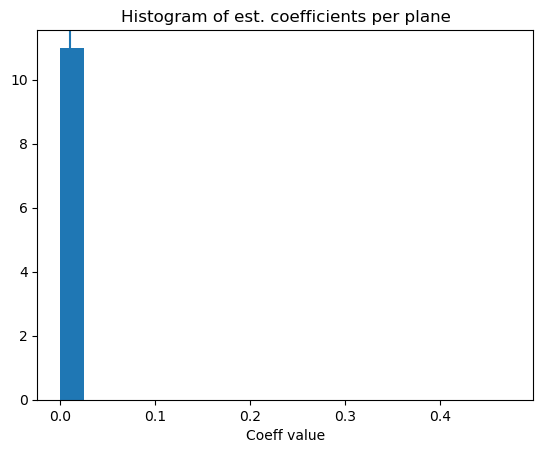

MovieWriter ffmpeg unavailable; using Pillow instead.


   Subtracting with estimated coefficient 0.010
         Subtracting plane 0 from 13
         Subtracting plane 1 from 14
         Subtracting plane 2 from 15
         Subtracting plane 3 from 16
         Subtracting plane 4 from 17
         Subtracting plane 5 from 18
         Subtracting plane 6 from 19
         Subtracting plane 7 from 20
         Subtracting plane 8 from 21
         Subtracting plane 9 from 22
         Subtracting plane 10 from 23
   Using 3d registration
   Computing plane alignment shifts
   Applying plane alignment shifts
(24, 400, 810, 672)
(24, 2)
[[  0   0]
 [  5  -7]
 [ 10 -15]
 [ 16 -23]
 [ 22 -31]
 [ 29 -40]
 [ 35 -48]
 [ 42 -57]
 [ 48 -65]
 [ 54 -73]
 [ 61 -81]
 [ 67 -88]
 [ 73 -95]
 [110 -95]
 [103 -83]
 [ 96 -72]
 [ 90 -61]
 [ 83 -49]
 [ 74 -38]
 [ 66 -26]
 [ 57 -14]
 [ 49  -3]
 [ 42   8]
 [ 35  18]]
   Launching 3D GPU reference image calculation
   Launched
      Seeding reference image with most active frames
      Completed iter 1 out of 8 in  10.06

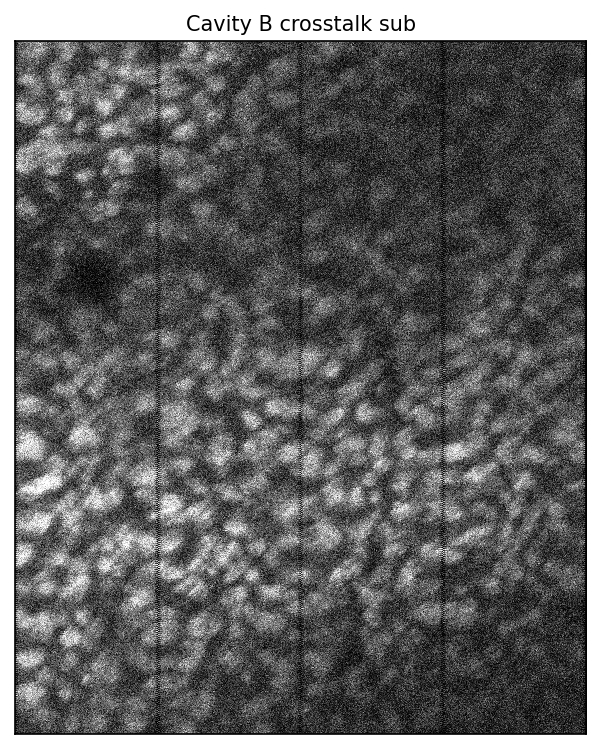

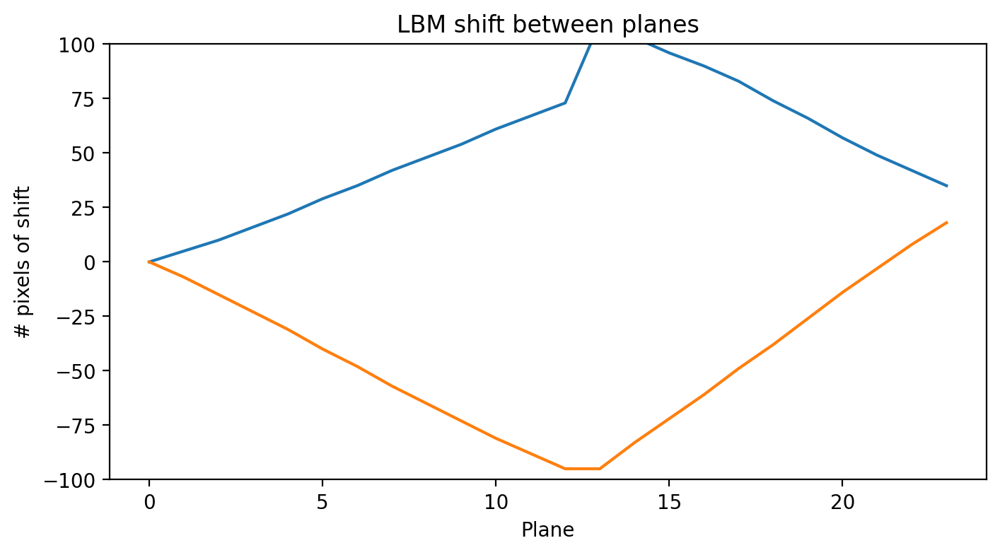

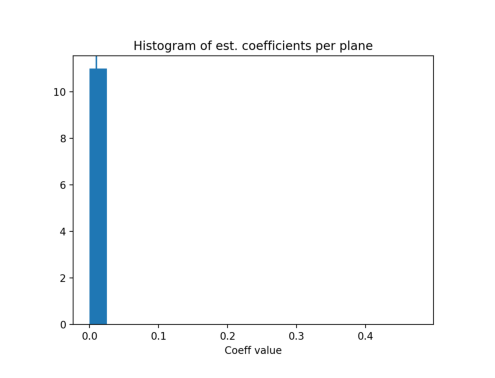

In [27]:
job.run_init_pass()

In [15]:
im3d = mov.mean(axis=1)

In [19]:
n.save(os.path.join(job.dirs['summary'], 'im3d.npy'), im3d)

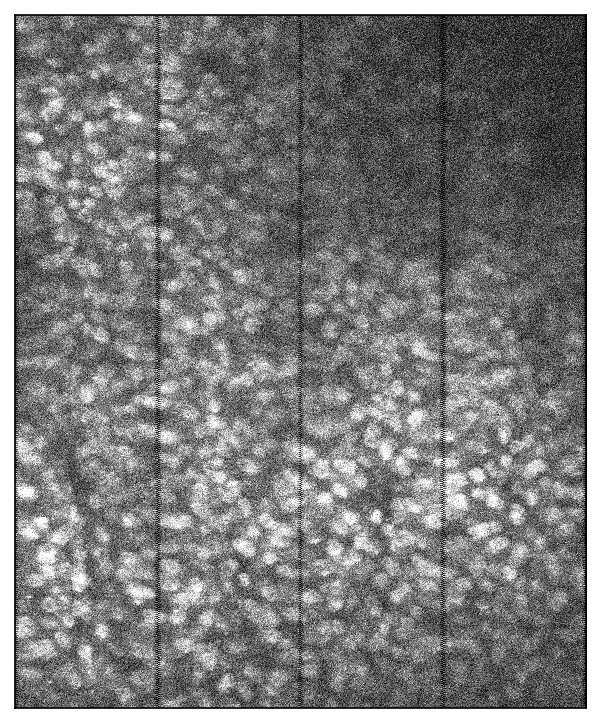

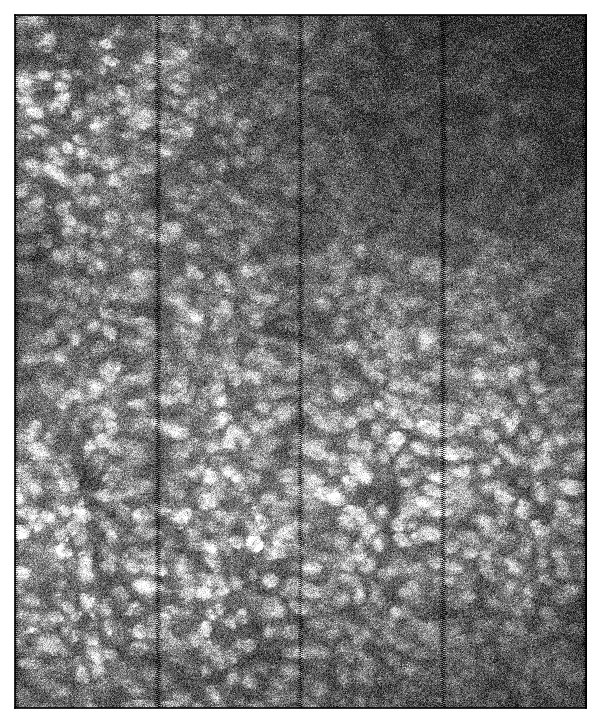

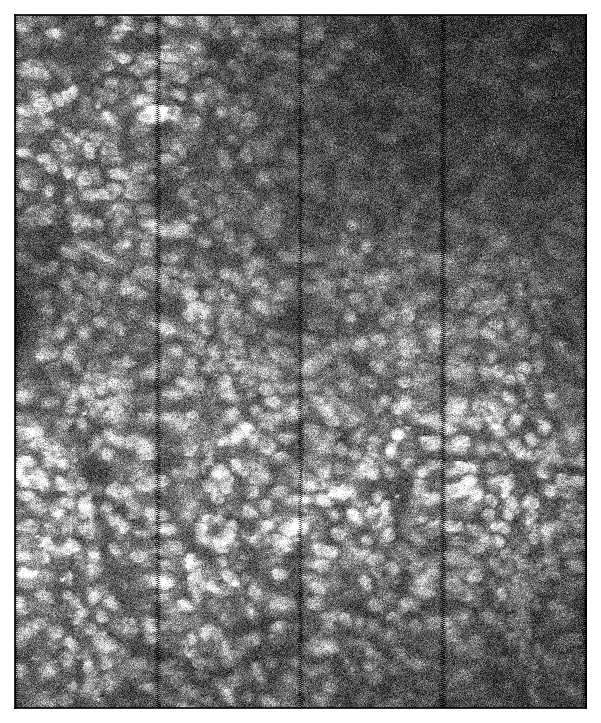

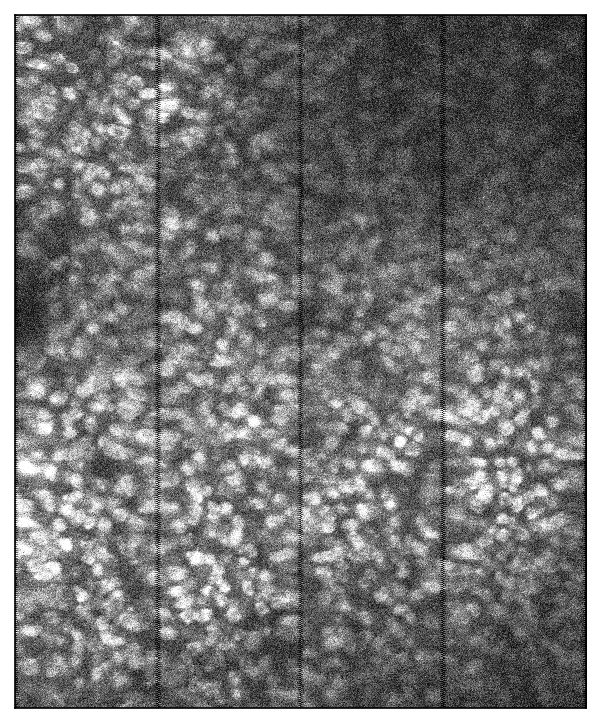

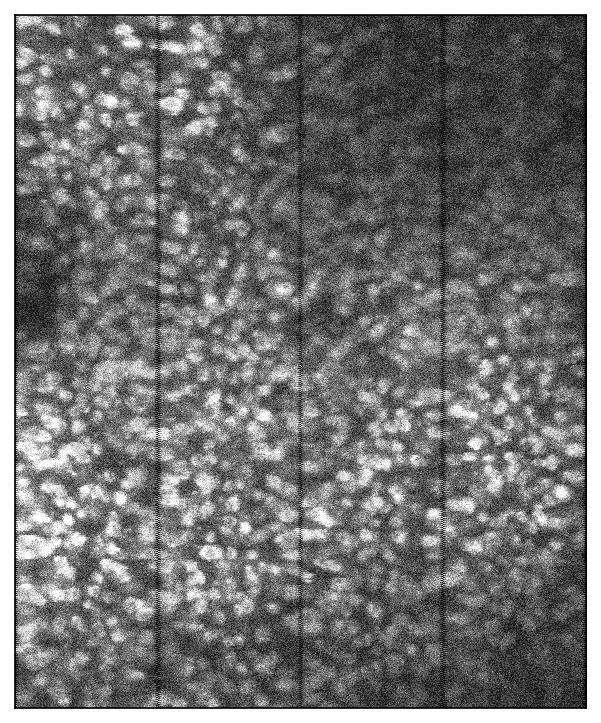

...

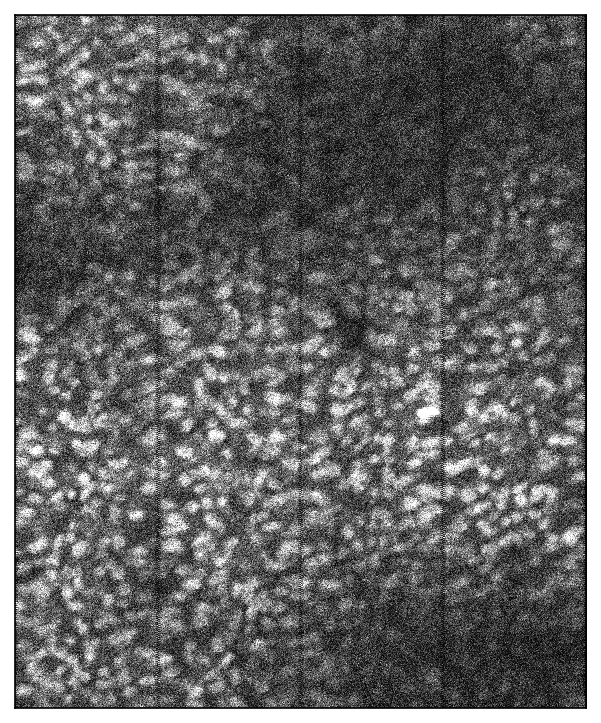

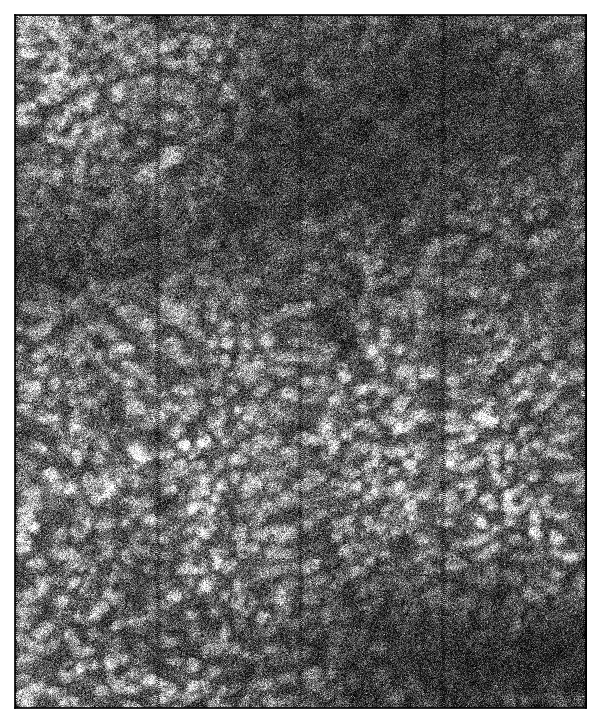

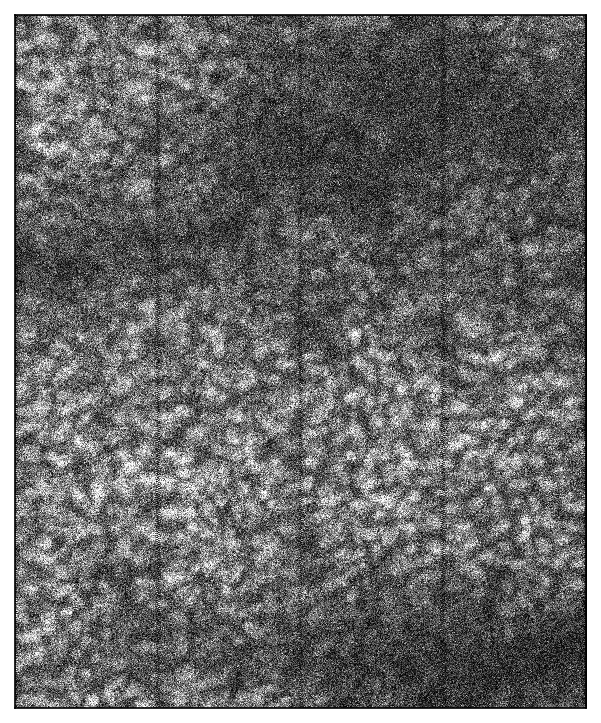

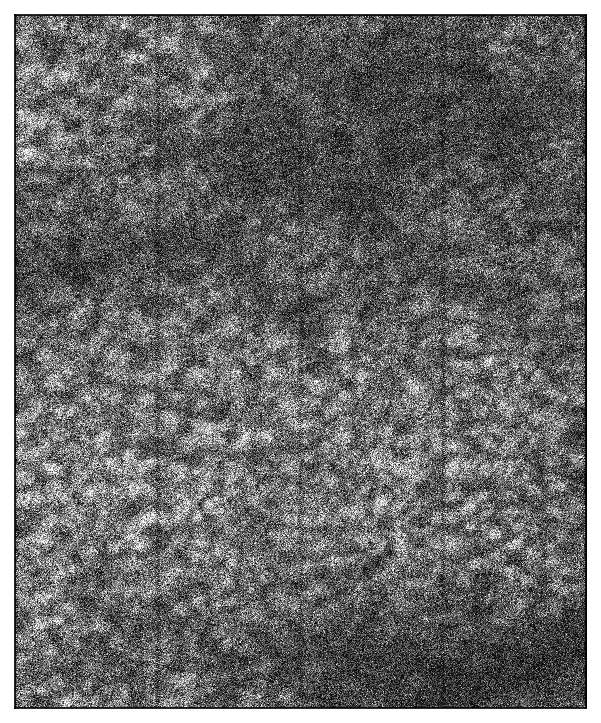

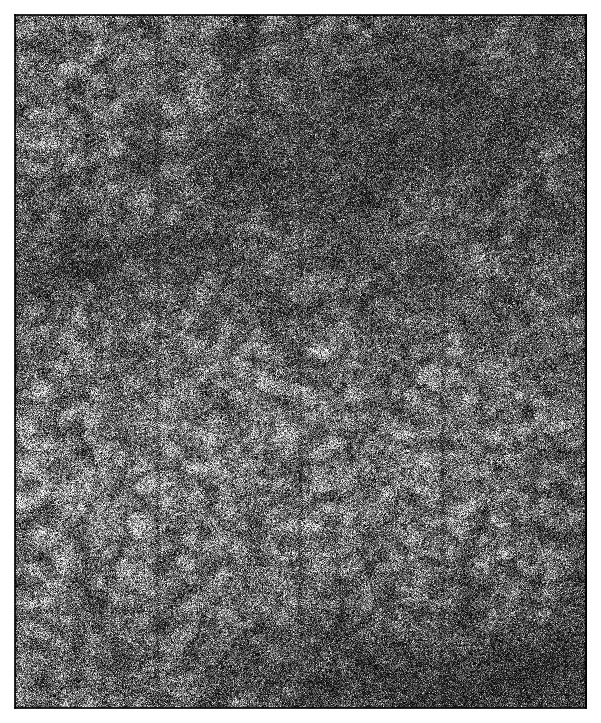

In [20]:
for i in range(im3d.shape[0]):
    tfu.show_tif(im3d[i])
    plt.show()

In [10]:
mov.shape

(24, 100, 700, 577)

In [ ]:
# %%time
# summary = job.run_init_pass()

In [ ]:
summary = job.load_summary()

In [ ]:
img = summary['ref_img_3d']

In [ ]:
# split the large tiffs into files of size 100 after registration
job.params['split_tif_size'] = 100

In [ ]:
%%time
job.register_gpu_3d()

In [ ]:
mov_full = job.get_registered_movie('registered_fused_data', 'fused')
im_full = mov_full[:,:200].mean(axis=1).compute()

In [ ]:
tfu.show_tif(im_full[0])

In [ ]:
job.params['cell_filt_type'] = 'gaussian'

job.params['voxel_size_um'] = (20, 3.33, 3.33)
job.params['npil_filt_xy_um'] = 70
job.params['cell_filt_xy_um'] = 5
job.params['sdnorm_exp'] = 0.80

params_to_sweep = {
    'cell_filt_xy_um' : (5,10),
    'npil_filt_xy_um' : (40, 70, 100),
    'sdnorm_exp' : (0.8,1.0),
}
job.sweep_corrmap(params_to_sweep, iter_limit=1)

In [ ]:
%%time
corr_map = job.calculate_corr_map()

In [ ]:
res = job.load_corr_map_results()
vmap = res['vmap']

In [ ]:
# most important parameter - any value of the corrmap
# above this will be considered a peak for a possible ROI,
# and will be used as a "seed" to grow an ROI around it
# bigger number: fewer ROIs, only bright ones
# smaller number: many ROIs, increasingly worse quality
job.params['peak_thresh'] = 2.9

# optionally, bin the movie in time to speed up detection
# probably a good idea if you have high framerate (>5 Hz?)
job.params['detection_timebin'] = 1 

# when extending an ROI, compare its activity to its neighboring pixels
# in frames where the fluorescence is above this percentile
job.params['percentile'] = 99.5


job.segment_rois()

In [ ]:
# rois_dir_path = job.combine_patches(n.arange(80), job.dirs['rois'], deduplicate=False,
#                                     parent_dir_name='segmentation', info_use_idx=None)

In [ ]:
job.compute_npil_masks(stats_dir = job.dirs['rois'])


In [ ]:

traces = job.extract_and_deconvolve(stats_dir=job.dirs['rois'],iscell=iscell)

In [ ]:
job.export_results('/mnt/zeytin-f1/s3d-results/',result_dir_name='rois')